# Main

In [1]:
class argObj:
    """
    This class is used to define the paths to the data and the submission directories
    """
    def __init__(self, subj, data_home_dir, data_dir, parent_submission_dir, 
                 parent_ncsnr_dir, images_trials_parent_dir, save):
        # Define the dir where data is stored
        self.data_home_dir = data_home_dir
        
        # 1 became 01
        self.subj = format(subj, '02') # '0numberofchars'
        self.data_dir = os.path.join(data_dir, 'subj'+self.subj)
        
        # fmri training data dir
        self.fmri_dir = os.path.join(self.data_dir, 'training_split', 'training_fmri')
        self.lh_fmri = os.path.join(self.fmri_dir, 'lh_training_fmri.npy')
        self.rh_fmri = os.path.join(self.fmri_dir, 'rh_training_fmri.npy')

        # stimuli data dir
        self.train_img_dir = os.path.join(self.data_dir, 'training_split', 'training_images')
        self.test_img_dir = os.path.join(self.data_dir, 'test_split', 'test_images')
        
        # NCSNR
        self.parent_ncsnr_dir = parent_ncsnr_dir
        self.ncsnr_dir = os.path.join(self.parent_ncsnr_dir, 'subj'+self.subj)
        
        # TEST PREDICTION SUBMISSION DIR
        self.parent_submission_dir = parent_submission_dir
        # Create the parent submission directory if not existing
        if not os.path.isdir(self.parent_submission_dir) and save:
            os.makedirs(self.parent_submission_dir)
        self.test_submission_dir = os.path.join(self.parent_submission_dir, "test_predictions")
        self.subject_test_submission_dir = os.path.join(self.test_submission_dir,
            'subj'+self.subj)
        # Create the submission directory if not existing
        if not os.path.isdir(self.subject_test_submission_dir) and save:
            os.makedirs(self.subject_test_submission_dir)
            
        # VAL PREDICTION SUBMISSION DIR
        self.val_submission_dir = os.path.join(self.parent_submission_dir, "val_predictions")
        self.subject_val_submission_dir = os.path.join(self.val_submission_dir,
            'subj'+self.subj)
        # Create the submission directory if not existing
        if not os.path.isdir(self.subject_val_submission_dir) and save:
            os.makedirs(self.subject_val_submission_dir)
            
        # VAL correlations SUBMISSION DIR
        self.val_correlation_dir = os.path.join(self.parent_submission_dir, "val_correlations")
        self.subject_val_correlation_dir = os.path.join(self.val_correlation_dir,
            'subj'+self.subj)
        # Create the correlation directory if not existing
        if not os.path.isdir(self.subject_val_correlation_dir) and save:
            os.makedirs(self.subject_val_correlation_dir)
          
        # VAL imgs submission dir
        self.val_images_submission_dir = os.path.join(self.parent_submission_dir, "val_imgs")
        # Create the parent submission directory if not existing
        if not os.path.isdir(self.val_images_submission_dir) and save:
            os.makedirs(self.val_images_submission_dir)
        self.subject_val_images_submission_dir = os.path.join(self.val_images_submission_dir,
            'subj'+self.subj)
        # Create the submission directory if not existing
        if not os.path.isdir(self.subject_val_images_submission_dir) and save:
            os.makedirs(self.subject_val_images_submission_dir)
            
        
            
        # ROY DIR
        self.roi_dir = os.path.join(self.data_dir, 'roi_masks')

        # Train Images Trials 
        self.images_trials_parent_dir = images_trials_parent_dir
        self.images_trials_dir = os.path.join(self.images_trials_parent_dir, 'subj'+self.subj)
        
        # fsaverage surfaces dir 
        self.fsaverage_surface_dir = os.path.join(self.data_home_dir, 'fsaverage_surface')
        
        # ROI advanced masks DIR
        
        self.roi_dir_enhanced = os.path.join(self.data_dir, 'roi_masks_enhanced')
        if not os.path.isdir(self.roi_dir_enhanced) and save:
            os.makedirs(self.roi_dir_enhanced)
            os.makedirs(os.path.join(self.roi_dir_enhanced, 'roi_classes_masks'))
            os.makedirs(os.path.join(self.roi_dir_enhanced, 'roi_masks'))
            os.makedirs(os.path.join(self.roi_dir_enhanced, 'unknown_masks'))
            
        self.roi_dir_enhanced_df = os.path.join(self.roi_dir_enhanced, 'roi_df')
        
    def images_idx_splitter(self, train_percentage):
        """
        This function splits the training and test images into training, validation and test partitions. 
        Given a percentage of the training images, it will assign that percentage to the training partition.
        """
        # Create lists will all training and test image file names, sorted
        train_img_list = os.listdir(self.train_img_dir)
        train_img_list.sort()
        test_img_list = os.listdir(self.test_img_dir)
        test_img_list.sort()
                
        ## Create the training, validation and test partitions indices ##
        # i set the random seed to 5 to have the same split for all the models
        rand_seed = 5 #@param
        np.random.seed(rand_seed)
        # train_percentage = 90
        # Calculate how many stimulus images correspond to 90% of the training data
        num_train = int(np.round(len(train_img_list) / 100 * train_percentage))
        # Shuffle all training stimulus images
        idxs = np.arange(len(train_img_list))
        np.random.shuffle(idxs)
        # Assign 90% of the shuffled stimulus images to the training partition,
        # and 10% to the test partition
        idxs_train, idxs_val = idxs[:num_train], idxs[num_train:]
        # No need to shuffle or split the test stimulus images
        idxs_test = np.arange(len(test_img_list))
        
        print('## Stimulus Images Loading: Info')
        print('Total train images: ' + str(len(train_img_list)))
        print('Training stimulus images: ' + format(len(idxs_train)))
        print('Validation stimulus images: ' + format(len(idxs_val)))
        print('Test stimulus images: ' + format(len(idxs_test)))
        print("\n")
        
        # Get the paths of all image files
        train_imgs_paths = sorted(list(Path(self.train_img_dir).iterdir()))
        test_imgs_paths = sorted(list(Path(self.test_img_dir).iterdir()))
        
        return idxs_train, idxs_val, idxs_test, train_imgs_paths, test_imgs_paths

In [2]:
import os
os.getcwd()

'/mnt/d/Projects/Thesis'

In [3]:
# import cortex
# cortex.download_subject('fsaverage')

In [3]:
# If you automatically downloaded this dataset using the command above, you can find the files by calling the following at the command prompt:
import cortex
file_store = cortex.options.config.get('basic', 'filestore')
file_path = os.path.join(file_store, 'fsaverage', 'overlays.svg')
print(file_path)

/home/giorgio/miniconda3/envs/pycortex/share/pycortex/db/fsaverage/overlays.svg


In [5]:
# from importlib.metadata import version 
# version('imageio')

In [4]:
"""Plot data on a flattened brain surface using pycortex.

"""
import os
import numpy as np
from matplotlib import pyplot as plt
import cortex
import cortex.polyutils
import copy

In [5]:
from cortex.testing_utils import inkscape_version
inkscape_version()

'1.3'

In [6]:
# =============================================================================
# Map the data to fsaverage space
# =============================================================================
# pycortex requires data in fsaverage space, so here you map the vertices from
# Challenge space into fsaverage space. The voxels not used in the Challenge
# are given NaN values, so that pycortex ignores them for the plotting.
# "ls_scores" and "rh_scores" are lists with 8 elements, one for each subject.
# These elements consist of vectors of length N, where N is the vertex amount
# for each subject and hemisphere, and each vector component consists of the
# prediction accuracy for that vertex.

# define the submission to visualize
submission_name = '(2023-09-01_18-33)1_1_config_0.65567.json_2_2_config_0.63208.json_3_3_config_0.65337.json_4_4_config_0.67977.json_5_5_config_0.66019.json_6_6_config_0.55831.json_7_7_config_0.57815.json_8_8_config_0.59902.json'
submission_name = 'BASELINE'

# Data folder definition
data_home_dir = '../Datasets/Biomedical'
data_dir = '../Datasets/Biomedical/algonauts_2023_challenge_data'
ncsnr_dir = '../Datasets/Biomedical/algonauts_ncsnr'
images_trials_dir = '../Datasets/Biomedical/algonauts_train_images_trials'
parent_submission_dir = f'./files/submissions/{submission_name}'
save = True
hemispheres = ['left', 'right']
subjects = [1, 2, 3, 4, 5, 6, 7, 8]

# loading the scores
lh_scores = {}
rh_scores = {}
for s, sub in enumerate(subjects):
    args = argObj(sub, data_home_dir, data_dir, parent_submission_dir, 
                ncsnr_dir, images_trials_dir, save)
    subject_val_correlation_dir = args.subject_val_correlation_dir
    lh_scores[f'{sub}'] = np.load(os.path.join(subject_val_correlation_dir, 'lh_corr_val.npy'))
    rh_scores[f'{sub}'] = np.load(os.path.join(subject_val_correlation_dir, 'rh_corr_val.npy'))

In [7]:
lh_fsaverage = []
rh_fsaverage = []
for s, sub in enumerate(subjects):
    # load args for the current subject
    args = argObj(sub, data_home_dir, data_dir, parent_submission_dir, 
                ncsnr_dir, images_trials_dir, save)
    # load the fsaverage masks
    lh_mask_dir = os.path.join(args.roi_dir, 'lh.all-vertices_fsaverage_space.npy')
    rh_mask_dir = os.path.join(args.roi_dir, 'rh.all-vertices_fsaverage_space.npy')
    lh_fsaverage_all_vertices = np.load(lh_mask_dir)
    rh_fsaverage_all_vertices = np.load(rh_mask_dir)
    lh_fsavg = np.empty((len(lh_fsaverage_all_vertices)))
    lh_fsavg[:] = np.nan
    lh_fsavg[np.where(lh_fsaverage_all_vertices)[0]] = lh_scores[f'{sub}']
    lh_fsaverage.append(np.copy(lh_fsavg))
    rh_fsavg = np.empty((len(rh_fsaverage_all_vertices)))
    rh_fsavg[:] = np.nan
    rh_fsavg[np.where(rh_fsaverage_all_vertices)[0]] = rh_scores[f'{sub}']
    rh_fsaverage.append(np.copy(rh_fsavg))

In [10]:
# non_nan_count = np.count_nonzero(~np.isnan(lh_fsaverage[0]))

# print("Number of non-NaN values:", non_nan_count)
# print("Total number of vertices:", len(lh_fsaverage[0]))

In [11]:
# non_nan_values = lh_fsaverage[~np.isnan(lh_fsaverage)]  # Extract non-NaN values
# print("First 10 non-NaN values:", non_nan_values[:10])
# print("Number of non-NaN values:", len(non_nan_values))

In [12]:
# non_nan_count = np.count_nonzero(~np.isnan(np.nanmean(lh_fsaverage, 0)))

# print("Number of non-NaN values:", non_nan_count)

In [11]:
# Average the scores across subjects
lh_fsaverage_all = np.nanmean(lh_fsaverage, 0)
rh_fsaverage_all = np.nanmean(rh_fsaverage, 0)


# =============================================================================
# Plot parameters for colorbar
# =============================================================================
plt.rc('xtick', labelsize=19)
plt.rc('ytick', labelsize=19)

/tmp/ipykernel_403/1642727553.py:2: RuntimeWarning: Mean of empty slice
  lh_fsaverage_all = np.nanmean(lh_fsaverage, 0)
/tmp/ipykernel_403/1642727553.py:3: RuntimeWarning: Mean of empty slice
  rh_fsaverage_all = np.nanmean(rh_fsaverage, 0)


/home/giorgio/miniconda3/envs/pycortex/lib/python3.9/site-packages/cortex/quickflat/view.py:151: UserWarning: Use of `cvmin`, `cvmax`, and `cvthr` is deprecated! Please use 
`curvature_brightness`, `curvature_contrast`, and `curvature_threshold`
to set appearance of background curvature.
  warnings.warn(("Use of `cvmin`, `cvmax`, and `cvthr` is deprecated! Please use \n"


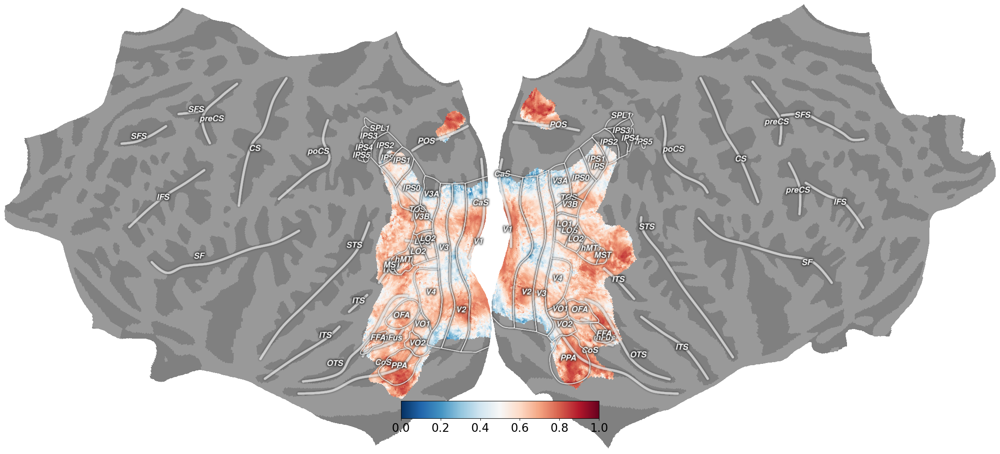

In [25]:
# =============================================================================
# Plot the results on brain surfaces
# =============================================================================
subject = 'fsaverage'
data = np.append(lh_fsaverage_all, rh_fsaverage_all)
vertex_data = cortex.Vertex(data, subject, cmap='RdBu_r', vmin=0, vmax=1)
cortex.quickshow(vertex_data, 
                 with_curvature=False, 
                 cvmin=-5., 
                 cvmax=5., 
                 cvthr=True, 
                 with_labels=True, 
                 with_rois=True,
                with_colorbar=True,
                with_borders=True,
                with_sulci=False,
                with_colorbar_label=True,
                with_curvature_colorbar=False,
                with_curvature_colorbar_label=False,
                with_curvature_colorbar_ticks=False)
plt.show()

In [51]:
# Average the scores across subjects
lh_fsaverage_all = lh_fsaverage[7]
rh_fsaverage_all = rh_fsaverage[7]


# =============================================================================
# Plot parameters for colorbar
# =============================================================================
plt.rc('xtick', labelsize=19)
plt.rc('ytick', labelsize=19)

In [54]:
# print the working directory
os.getcwd()

'/mnt/d/Projects/Thesis'

/tmp/ipykernel_492/1080696013.py:9: RuntimeWarning: Mean of empty slice
  lh_fsaverage_all = np.nanmean(lh_fsaverage, 0)
/tmp/ipykernel_492/1080696013.py:10: RuntimeWarning: Mean of empty slice
  rh_fsaverage_all = np.nanmean(rh_fsaverage, 0)
/home/giorgio/miniconda3/envs/pycortex/lib/python3.9/site-packages/cortex/quickflat/view.py:151: UserWarning: Use of `cvmin`, `cvmax`, and `cvthr` is deprecated! Please use 
`curvature_brightness`, `curvature_contrast`, and `curvature_threshold`
to set appearance of background curvature.
  warnings.warn(("Use of `cvmin`, `cvmax`, and `cvthr` is deprecated! Please use \n"
/home/giorgio/miniconda3/envs/pycortex/lib/python3.9/site-packages/cortex/quickflat/view.py:151: UserWarning: Use of `cvmin`, `cvmax`, and `cvthr` is deprecated! Please use 
`curvature_brightness`, `curvature_contrast`, and `curvature_threshold`
to set appearance of background curvature.
  warnings.warn(("Use of `cvmin`, `cvmax`, and `cvthr` is deprecated! Please use \n"
/home/gio

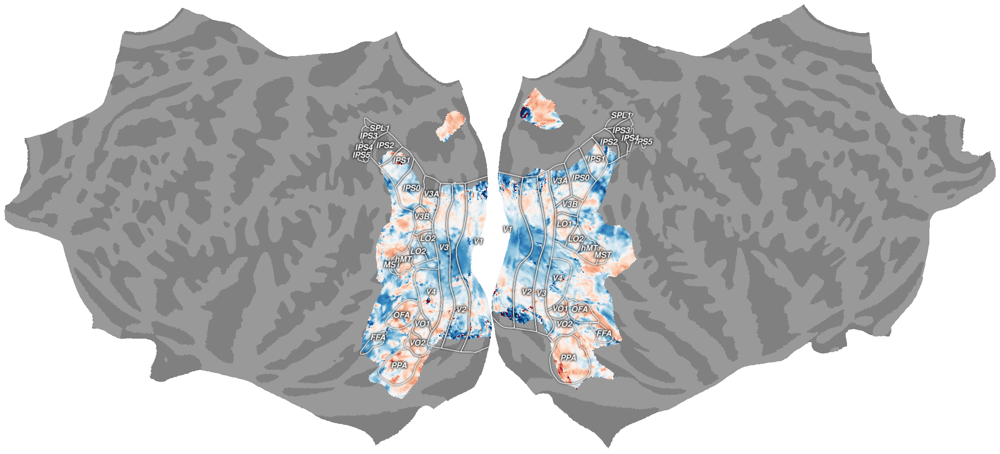

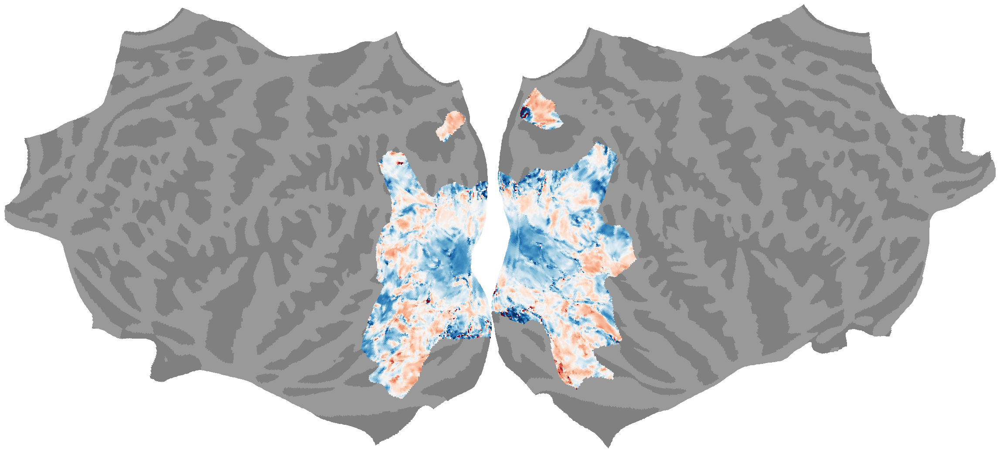

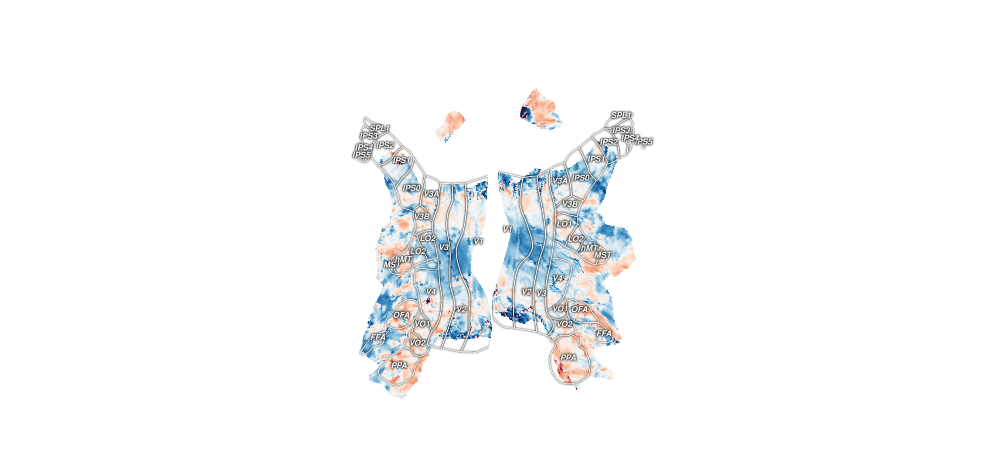

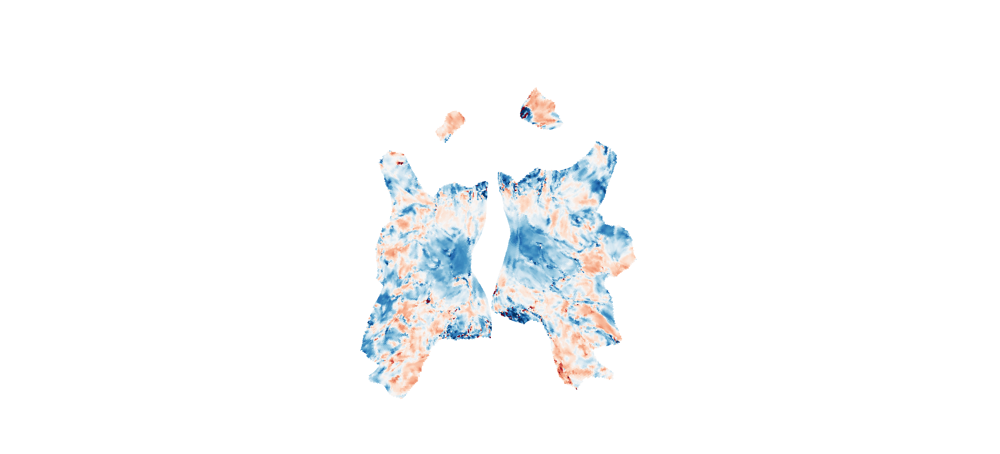

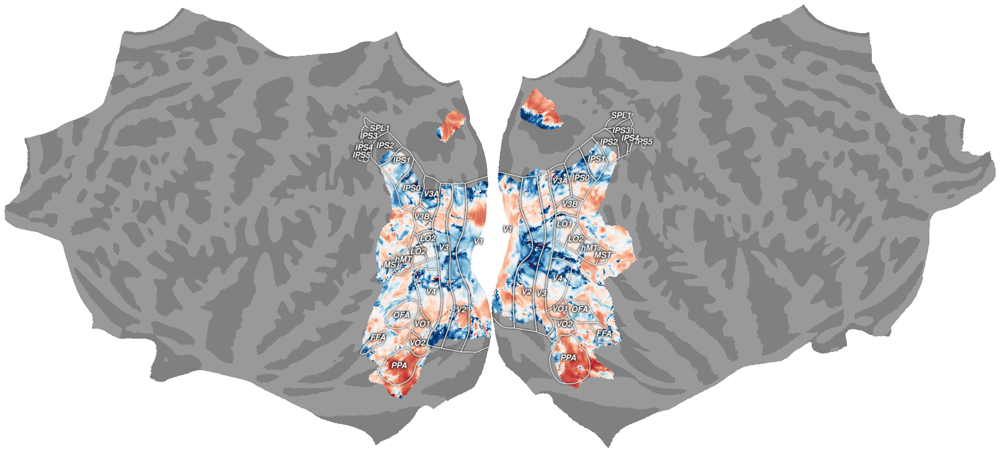

...

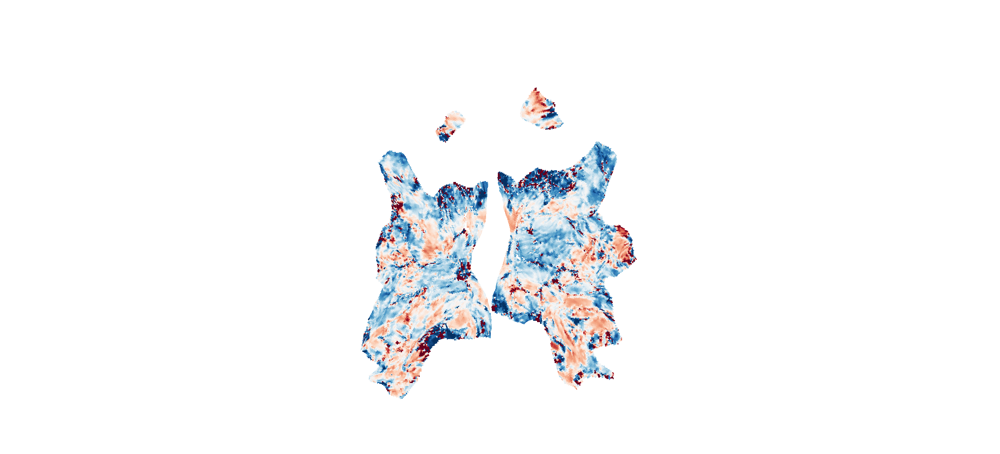

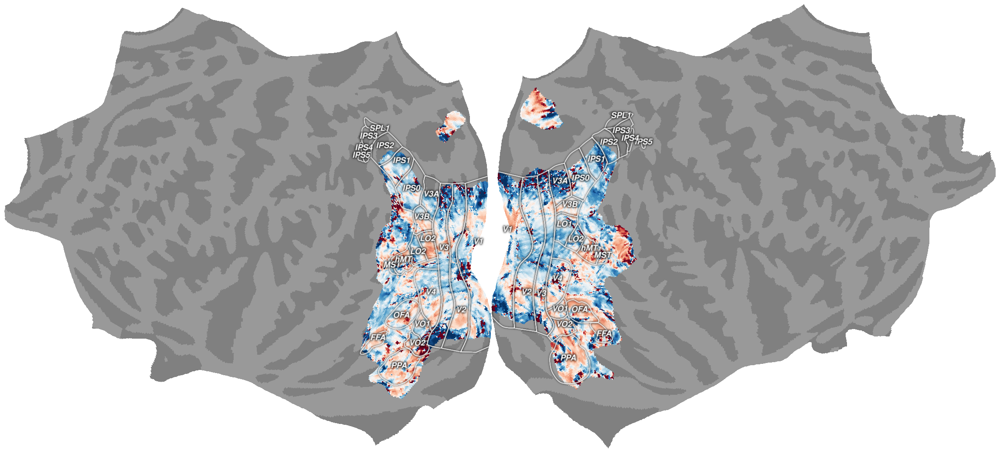

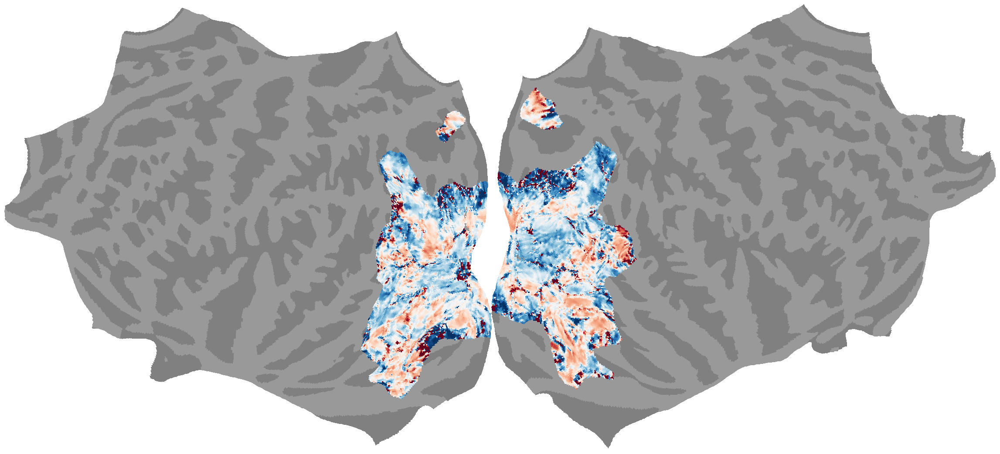

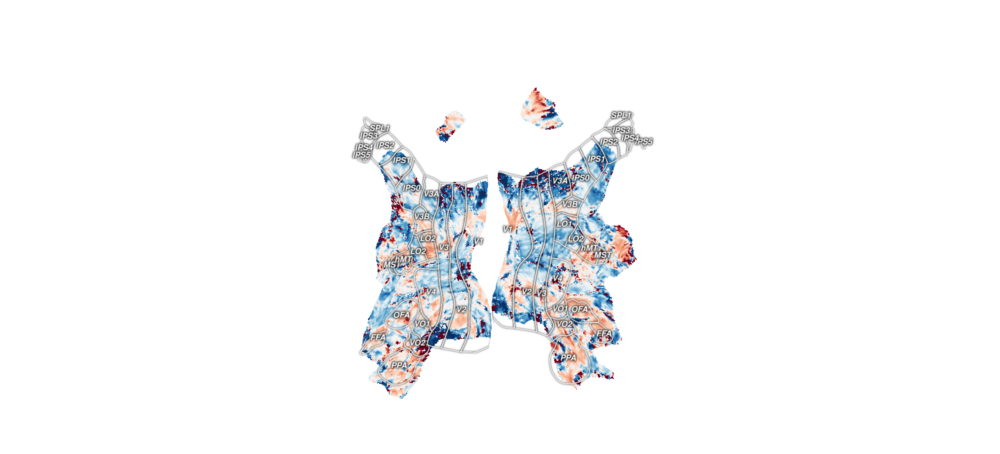

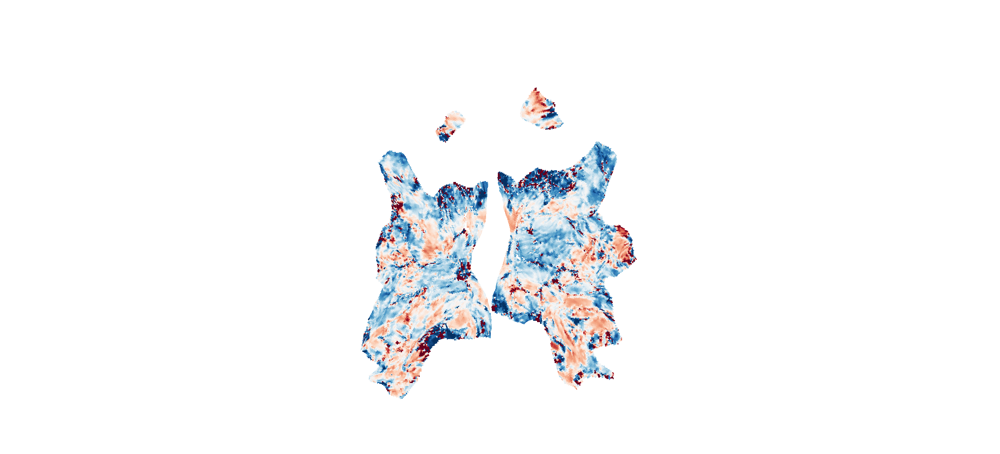

In [10]:
# =============================================================================
# Plot the results on brain surfaces
# =============================================================================

save = "./files/0_analysis/images/cortical_best"
save = "./files/0_analysis/images/cortical_baseline"
subjects = [1, 2, 3, 4, 5, 6, 7, 8, "All"]
subject = 'fsaverage'
lh_fsaverage_all = np.nanmean(lh_fsaverage, 0)
rh_fsaverage_all = np.nanmean(rh_fsaverage, 0)
lh_fsaverage_all = lh_fsaverage[7]
rh_fsaverage_all = rh_fsaverage[7]

with_curvature_bool = [True, False]
with_rois_bool = [True, False]


for sub in subjects:
    if sub == "All":
        data = np.append(lh_fsaverage_all, rh_fsaverage_all)
    else:
        data = np.append(lh_fsaverage[sub-1], rh_fsaverage[sub-1])
    vertex_data = cortex.Vertex(data, subject, cmap='RdBu_r', vmin=0, vmax=1)
    for with_curvature in with_curvature_bool:
        for with_rois in with_rois_bool:
            cortex.quickshow(vertex_data, 
                             with_curvature=with_curvature, 
                             cvmin=-5., 
                             cvmax=5., 
                             cvthr=True, 
                             with_labels=True, 
                             with_rois=with_rois,
                            with_colorbar=False,
                            with_borders=True,
                            with_sulci=False,
                            with_colorbar_label=True,
                            with_curvature_colorbar=False,
                            with_curvature_colorbar_label=False,
                            with_curvature_colorbar_ticks=False)
            plt.savefig(f'{save}/{sub}_curvature_{with_curvature}_rois_{with_rois}.png')

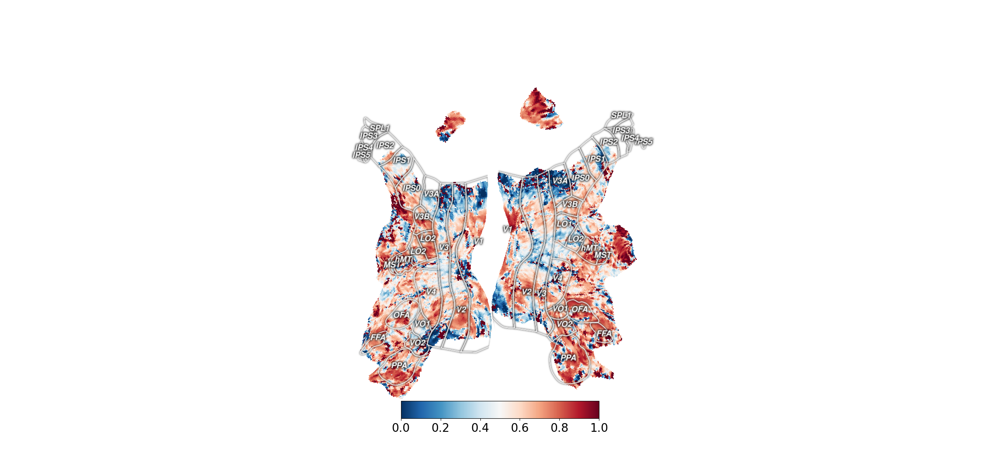

In [61]:
plt.rc('xtick', labelsize=19)
plt.rc('ytick', labelsize=19)
subject = 'fsaverage'
data = np.append(lh_fsaverage_all, rh_fsaverage_all)
vertex_data = cortex.Vertex(data, subject, cmap='RdBu_r', vmin=0, vmax=1)
cortex.quickshow(vertex_data, 
                 with_curvature=False, 
                 cvmin=-5., 
                 cvmax=5., 
                 cvthr=True, 
                 with_labels=True, 
                 with_rois=True,
                with_colorbar=True,
                with_borders=True,
                with_sulci=False,
                with_colorbar_label=True,
                with_curvature_colorbar=False,
                with_curvature_colorbar_label=False,
                with_curvature_colorbar_ticks=False)
#plt.savefig('nome_del_file.png')  # Sostituisci 'nome_del_file.png' con il nome del file che preferisci
plt.show()

# Codice fornitomi

Q&A with challenge submitters:

ME: Could you publish the code to realise the brain surface heatmaps visualisations ?
I would like to use the visualisations you recently posted on the leaderboard; I kindly ask you for the code to make them.

I was also wondering where I should send my submission (as my visualisation is missing).

Kind regards

Giorgio

ADMIN: 

Hi Giorgio,

For the visualizations we used pycortex (https://github.com/gallantlab/pycortex). Once you install it, you will have to install the fsaverage subject template from here (https://figshare.com/articles/dataset/fsaverage_subject_for_pycortex/9916166/1). You can then plot your results using the code at this link (https://drive.google.com/file/d/1cvJWNCs-aCiLyLAZnBu2LoKr4bSRIuZ3/view?usp=sharing).

As for your submission, please send it to "algonauts.mit@gmail.com", and we will then add your visualization.

The Algonauts Team

In [69]:

# =============================================================================
# Map the data to fsaverage space
# =============================================================================
# pycortex requires data in fsaverage space, so here you map the vertices from
# Challenge space into fsaverage space. The voxels not used in the Challenge
# are given NaN values, so that pycortex ignores them for the plotting.
# "ls_scores" and "rh_scores" are lists with 8 elements, one for each subject.
# These elements consist of vectors of length N, where N is the vertex amount
# for each subject and hemisphere, and each vector component consists of the
# prediction accuracy for that vertex.

challenge_data_dir = '../algonauts_2023_challenge_data'
lh_fsaverage = []
rh_fsaverage = []
for s, sub in enumerate(subjects):
	lh_mask_dir = os.path.join(challenge_data_dir, 'subj'+format(sub, '02'),
		'roi_masks', 'lh.all-vertices_fsaverage_space.npy')
	rh_mask_dir = os.path.join(challenge_data_dir, 'subj'+format(sub, '02'),
		'roi_masks', 'rh.all-vertices_fsaverage_space.npy')
	lh_fsaverage_all_vertices = np.load(lh_mask_dir)
	rh_fsaverage_all_vertices = np.load(rh_mask_dir)
	lh_fsavg = np.empty((len(lh_fsaverage_all_vertices)))
	lh_fsavg[:] = np.nan
	lh_fsavg[np.where(lh_fsaverage_all_vertices)[0]] = lh_scores[s]
	lh_fsaverage.append(copy(lh_fsavg))
	rh_fsavg = np.empty((len(rh_fsaverage_all_vertices)))
	rh_fsavg[:] = np.nan
	rh_fsavg[np.where(rh_fsaverage_all_vertices)[0]] = rh_scores[s]
	rh_fsaverage.append(copy(rh_fsavg))

# Average the scores across subjects
lh_fsaverage = np.nanmean(lh_fsaverage, 0)
rh_fsaverage = np.nanmean(rh_fsaverage, 0)


# =============================================================================
# Plot parameters for colorbar
# =============================================================================
plt.rc('xtick', labelsize=19)
plt.rc('ytick', labelsize=19)


# =============================================================================
# Plot the results on brain surfaces
# =============================================================================
subject = 'fsaverage'
data = np.append(lh_fsaverage, rh_fsaverage)
vertex_data = cortex.Vertex(data, subject, cmap='RdBu_r', vmin=0, vmax=100)
cortex.quickshow(vertex_data, with_curvature=True)
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: '../algonauts_2023_challenge_data/subj01/roi_masks/lh.all-vertices_fsaverage_space.npy'